In [ ]:
import anndata as ad
import numpy as np
import pandas as pd
import novaice
import scanpy as sc

In [ ]:
counts = pd.read_csv(
    "/Users/lucas-diedrich/Documents/Programming/nucleate-hackathon/nucleate-hackathon-2025/preprocessing/dataset-1/MCE_Bioactive_Compounds_HEK293T_10μM_Counts.csv"
)
counts

/var/folders/py/838_q5nd6594y27wbrpkhl3h0000gn/T/ipykernel_38223/2930088961.py:1: DtypeWarning: Columns (1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251

,Note: All these datasets are for non-commercial research use only,Unnamed: 1,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,...,Unnamed: 3398,Unnamed: 3399,Unnamed: 3400,Unnamed: 3401,Unnamed: 3402,Unnamed: 3403,Unnamed: 3404,Unnamed: 3405,Unnamed: 3406,Unnamed: 3407
0,Sample_id,A2M,A4GNT,AARS,ABCA1,ABCB1,ABCB6,ABCC5,ABCC8,ABCF1,...,ZNF185,ZNF274,ZNF281,ZNF318,ZNF395,ZNF451,ZNF586,ZNF589,ZW10,ZYX
1,MCE5_293T_24H_X1:D10,0,0,26,0,7,0,3,0,15,...,0,5,0,7,1,253,2,23,2,3
2,MCE5_293T_24H_X1:G14,0,0,97,0,7,0,12,1,82,...,2,8,4,47,3,365,5,26,20,11
3,MCE5_293T_24H_X1:G22,0,0,185,1,6,0,31,0,169,...,0,34,2,96,6,483,11,47,54,36
4,MCE5_293T_24H_X1:O22,0,0,0,0,0,0,0,0,2,...,0,0,0,0,0,2,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
40774,MCE4_293T_24H_X3:P01,0,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0
40775,MCE4_293T_24H_X3:L21,1,0,79,0,5,0,15,0,57,...,0,16,2,40,1,219,9,18,21,9
40776,MCE4_293T_24H_X3:P13,0,0,25,0,3,0,1,0,13,...,0,3,1,7,0,49,2,5,1,2
40777,MCE4_293T_24H_X3:J23,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
metadata = pd.read_csv(
    "/Users/lucas-diedrich/Documents/Programming/nucleate-hackathon/nucleate-hackathon-2025/preprocessing/dataset-1/MCE_Bioactive_Compounds_HEK293T_10μM_MetaData.csv",
    skiprows=[0],
)
metadata

,unique_ID,experiment_no,sample_plate,sample_row,sample_column,cell_id,pert_itime,pert_idose,sample,treatment
0,MCE5_293T_24H_X1:D10,MCE_20220606,MCE5_293T_24H_X1,4,10,cell_293T,24 h,10.0 uM,HY_50946,HY_50946
1,MCE5_293T_24H_X1:G14,MCE_20220606,MCE5_293T_24H_X1,7,14,cell_293T,24 h,10.0 uM,HY_18686,HY_18686
2,MCE5_293T_24H_X1:G22,MCE_20220606,MCE5_293T_24H_X1,7,22,cell_293T,24 h,10.0 uM,HY_17592A,HY_17592A
3,MCE5_293T_24H_X1:O22,MCE_20220606,MCE5_293T_24H_X1,15,22,cell_293T,24 h,10.0 uM,HY_19411,HY_19411
4,MCE5_293T_24H_X1:G08,MCE_20220606,MCE5_293T_24H_X1,7,8,cell_293T,24 h,10.0 uM,HY_18522,HY_18522
...,...,...,...,...,...,...,...,...,...,...
40773,MCE4_293T_24H_X3:P01,MCE_20221009_3,MCE4_293T_24H_X3,16,1,cell_293T,24 h,-666,Blank_42,Blank
40774,MCE4_293T_24H_X3:L21,MCE_20221009_3,MCE4_293T_24H_X3,12,21,cell_293T,24 h,10.0 uM,HY_13954,HY_13954
40775,MCE4_293T_24H_X3:P13,MCE_20221009_3,MCE4_293T_24H_X3,16,13,cell_293T,24 h,10.0 uM,HY_15414,HY_15414
40776,MCE4_293T_24H_X3:J23,MCE_20221009_3,MCE4_293T_24H_X3,10,23,cell_293T,24 h,-666,DMSO_02,DMSO


In [ ]:
counts = pd.read_csv(
    "/Users/lucas-diedrich/Documents/Programming/nucleate-hackathon/nucleate-hackathon-2025/preprocessing/dataset-1/MCE_Bioactive_Compounds_HEK293T_10μM_Counts.csv",
    skiprows=[0],
    index_col=0,
).reindex(metadata["unique_ID"])
counts

,A2M,A4GNT,AARS,ABCA1,ABCB1,ABCB6,ABCC5,ABCC8,ABCF1,ABCF3,...,ZNF185,ZNF274,ZNF281,ZNF318,ZNF395,ZNF451,ZNF586,ZNF589,ZW10,ZYX
unique_ID,,,,,,,,,,,,,,,,,,,,,
MCE5_293T_24H_X1:D10,0,0,26,0,7,0,3,0,15,0,...,0,5,0,7,1,253,2,23,2,3
MCE5_293T_24H_X1:G14,0,0,97,0,7,0,12,1,82,1,...,2,8,4,47,3,365,5,26,20,11
MCE5_293T_24H_X1:G22,0,0,185,1,6,0,31,0,169,0,...,0,34,2,96,6,483,11,47,54,36
MCE5_293T_24H_X1:O22,0,0,0,0,0,0,0,0,2,0,...,0,0,0,0,0,2,0,1,0,0
MCE5_293T_24H_X1:G08,0,0,21,0,0,0,2,0,15,0,...,0,3,0,15,0,100,1,5,3,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MCE4_293T_24H_X3:P01,0,0,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0
MCE4_293T_24H_X3:L21,1,0,79,0,5,0,15,0,57,1,...,0,16,2,40,1,219,9,18,21,9
MCE4_293T_24H_X3:P13,0,0,25,0,3,0,1,0,13,0,...,0,3,1,7,0,49,2,5,1,2


In [ ]:
adata = ad.AnnData(
    X=counts.values,
    obs=metadata,
    var=counts.columns.to_frame(index=True)
    .rename_axis(index=None)
    .rename(columns={0: "gene_name"}),
)

adata

/Users/lucas-diedrich/mamba/envs/hackathon/lib/python3.12/functools.py:912: ImplicitModificationWarning: Transforming to str index.
  return dispatch(args[0].__class__)(*args, **kw)


AnnData object with n_obs × n_vars = 40778 × 3407
    obs: 'unique_ID', 'experiment_no', 'sample_plate', 'sample_row', 'sample_column', 'cell_id', 'pert_itime', 'pert_idose', 'sample', 'treatment'
    var: 'gene_name'

In [ ]:
compound_metadata = pd.read_csv(
    "/Users/lucas-diedrich/Documents/Programming/nucleate-hackathon/nucleate-hackathon-2025/preprocessing/dataset-1/cas-to-smiles/compounds.csv"
)
compound_metadata

,Ranking,Catalog Number,Score,Compound name,Treatment concentration,CAS Number
0,1,HY_107369,0.367344,4-Butylresorcinol,10 μM,18979-61-8
1,2,HY_119674A,0.366090,Xanthopterin (hydrate),10 μM,5979-01-1
2,3,HY_19747,0.345520,HPOB,10 μM,1429651-50-2
3,4,HY_114177,0.339016,PF-06873600,10 μM,2185857-97-8
4,5,HY_105917,0.336668,Endovion,10 μM,265646-85-3
...,...,...,...,...,...,...
12350,12351,HY_136250,-0.274049,BSJ-03-204,10 μM,2349356-09-6
12351,12352,HY_138694,-0.275973,5-Benzyloxygramine,10 μM,1453-97-0
12352,12353,HY_10716A,-0.276133,PF-03463275,10 μM,1173239-39-8
12353,12354,HY_13515,-0.277132,Sirtinol,10 μM,410536-97-9


In [ ]:
compound_mapping = pd.read_csv(
    "/Users/lucas-diedrich/Documents/Programming/nucleate-hackathon/nucleate-hackathon-2025/preprocessing/dataset-1/cas-to-smiles/CAS_to_smiles.tsv",
    sep="\t",
    index_col=0,
)
compound_mapping

,CID,CAS,smiles
0,2,5080-50-2,CC(=O)OC(CC(=O)O)C[N+](C)(C)C
1,7,2715-68-6,CCN1C=NC2=C(N=CN=C21)N
2,19,303-38-8,C1=CC(=C(C(=C1)O)O)C(=O)O
3,43,103404-90-6,C(CC(=O)O)C(C(=O)O)O
4,47,1460-34-0,CCC(C)C(=O)C(=O)O
...,...,...,...
45831,176541418,474-25-9,C[C@H](CCC(=O)O)[C@H]1CCC2[C@@]1(CC[C@@H]3[C@@...
45832,176542861,13292-46-1,C[C@H]1/C=C(/C=C(/C(=O)NC2=C(C(=C3C(=C2O)C(=C(...
45833,176544248,129-16-8,C1=CC=C2C(=C1)C(=O)OC23C4=CC(=C(C=C4OC5=C=C([C...
45834,176546160,3810-74-0,C[C@@H]1[C@]([C@@H]([C@H](O1)O[C@@H]2[C@H]([C@...


In [ ]:
compound_metadata_annotated = (
    pd.merge(
        compound_metadata,
        compound_mapping,
        left_on="CAS Number",
        right_on="CAS",
        how="inner",
    )
    .drop_duplicates(["CAS Number", "Catalog Number"])
    .drop(
        columns=[
            "Score",
            "Treatment concentration",
        ]
    )
)
compound_metadata_annotated

,Ranking,Catalog Number,Compound name,CAS Number,CID,CAS,smiles
0,1,HY_107369,4-Butylresorcinol,18979-61-8,205912,18979-61-8,CCCCC1=C(C=C(C=C1)O)O
1,2,HY_119674A,Xanthopterin (hydrate),5979-01-1,261738,5979-01-1,C1=CC=C(C=C1)C(C2=CC=CC=C2)(C3=CC=CC=C3)OCC4C(...
9,3,HY_19747,HPOB,1429651-50-2,71532921,1429651-50-2,C1=CC=C(C=C1)N(CCO)C(=O)CC2=CC=C(C=C2)C(=O)NO
10,4,HY_114177,PF-06873600,2185857-97-8,134247638,2185857-97-8,C[C@]1(CCC[C@H]1N2C3=NC(=NC=C3C=C(C2=O)C(F)F)N...
13,5,HY_105917,Endovion,265646-85-3,10005966,265646-85-3,C1=CC(=C(C=C1Br)C2=NNN=N2)NC(=O)NC3=CC(=CC(=C3...
...,...,...,...,...,...,...,...
49721,12351,HY_136250,BSJ-03-204,2349356-09-6,137628658,2349356-09-6,CC1=C(C(=O)N(C2=NC(=NC=C12)NC3=NC=C(C=C3)N4CCN...
49723,12352,HY_138694,5-Benzyloxygramine,1453-97-0,73814,1453-97-0,CN(C)CC1=CNC2=C1C=C(C=C2)OCC3=CC=CC=C3
49726,12353,HY_10716A,PF-03463275,1173239-39-8,44156901,1173239-39-8,CN1C[C@@H]2[C@H](C1)C2CN(CC3=CC(=C(C=C3)F)Cl)C...
49728,12354,HY_13515,Sirtinol,410536-97-9,1376645,410536-97-9,C[C@@H](C1=CC=CC=C1)NC(=O)C2=CC=CC=C2N=CC3=C(C...


In [ ]:
adata.obs = adata.obs.merge(
    compound_metadata_annotated,
    left_on="treatment",
    right_on="Catalog Number",
    how="left",
)

/Users/lucas-diedrich/mamba/envs/hackathon/lib/python3.12/functools.py:912: ImplicitModificationWarning: Transforming to str index.
  return dispatch(args[0].__class__)(*args, **kw)


In [ ]:
novaice.pp.foundation_model_embeddings(
    adata,
    smiles_col="smiles",
    model_name="ibm-research/MoLFormer-XL-both-10pct",
    device="cpu",
)

In [ ]:
novaice.pp.morgan_fingerprints(
    adata,
    smiles_col="smiles",
)

[05:30:12] DEPRECATION WARNING: please use MorganGenerator
[05:30:12] DEPRECATION WARNING: please use MorganGenerator
[05:30:12] DEPRECATION WARNING: please use MorganGenerator
[05:30:12] DEPRECATION WARNING: please use MorganGenerator
[05:30:12] DEPRECATION WARNING: please use MorganGenerator
[05:30:12] DEPRECATION WARNING: please use MorganGenerator
[05:30:12] DEPRECATION WARNING: please use MorganGenerator
[05:30:12] DEPRECATION WARNING: please use MorganGenerator
[05:30:12] DEPRECATION WARNING: please use MorganGenerator
[05:30:12] DEPRECATION WARNING: please use MorganGenerator
[05:30:12] DEPRECATION WARNING: please use MorganGenerator
[05:30:12] DEPRECATION WARNING: please use MorganGenerator
[05:30:12] DEPRECATION WARNING: please use MorganGenerator
[05:30:12] DEPRECATION WARNING: please use MorganGenerator
[05:30:12] DEPRECATION WARNING: please use MorganGenerator
[05:30:12] DEPRECATION WARNING: please use MorganGenerator
[05:30:12] DEPRECATION WARNING: please use MorganGenerat

In [ ]:
adata.layers["counts"] = adata.X.copy()

In [ ]:
sc.pp.normalize_total(adata, target_sum=1e6)
sc.pp.log1p(adata)

In [ ]:
sc.pp.pca(adata)

In [ ]:
sc.pp.neighbors(adata)

In [ ]:
sc.tl.umap(adata, random_state=42)

In [ ]:
adata.obs

,unique_ID,experiment_no,sample_plate,sample_row,sample_column,cell_id,pert_itime,pert_idose,sample,treatment,Ranking,Catalog Number,Compound name,CAS Number,CID,CAS,smiles
0,MCE5_293T_24H_X1:D10,MCE_20220606,MCE5_293T_24H_X1,4,10,cell_293T,24 h,10.0 uM,HY_50946,HY_50946,6471.0,HY_50946,Imatinib (Mesylate),220127-57-1,3427.0,220127-57-1,CC(=CCCC(=CCCC(=CCSC1=NC=NN1)C)C)C
1,MCE5_293T_24H_X1:G14,MCE_20220606,MCE5_293T_24H_X1,7,14,cell_293T,24 h,10.0 uM,HY_18686,HY_18686,11581.0,HY_18686,AS1949490,1203680-76-5,44473434.0,1203680-76-5,C[C@@H](C1=CC=CC=C1)NC(=O)C2=C(C=CS2)OCC3=CC=C...
2,MCE5_293T_24H_X1:G22,MCE_20220606,MCE5_293T_24H_X1,7,22,cell_293T,24 h,10.0 uM,HY_17592A,HY_17592A,10898.0,HY_17592A,Bithionol (sulfoxide),844-26-8,68939.0,844-26-8,C1=C(C=C(C(=C1S(=O)C2=C(C(=CC(=C2)Cl)Cl)O)O)Cl)Cl
3,MCE5_293T_24H_X1:O22,MCE_20220606,MCE5_293T_24H_X1,15,22,cell_293T,24 h,10.0 uM,HY_19411,HY_19411,290.0,HY_19411,SSR180711 (hydrochloride),446031-79-4,9928899.0,446031-79-4,C1CN2CCC1N(CC2)C(=O)OC3=CC=C(C=C3)Br.Cl
4,MCE5_293T_24H_X1:G08,MCE_20220606,MCE5_293T_24H_X1,7,8,cell_293T,24 h,10.0 uM,HY_18522,HY_18522,8793.0,HY_18522,AA26-9,1312782-34-5,46829239.0,1312782-34-5,C1CCN(C1)C(=O)N2C=CN=N2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
40773,MCE4_293T_24H_X3:P01,MCE_20221009_3,MCE4_293T_24H_X3,16,1,cell_293T,24 h,-666,Blank_42,Blank,NaN,NaN,NaN,NaN,NaN,NaN,NaN
40774,MCE4_293T_24H_X3:L21,MCE_20221009_3,MCE4_293T_24H_X3,12,21,cell_293T,24 h,10.0 uM,HY_13954,HY_13954,12102.0,HY_13954,A 839977,870061-27-1,53325875.0,870061-27-1,C1=CC=C(C(=C1)CNC2=NN=NN2C3=C(C(=CC=C3)Cl)Cl)O...
40775,MCE4_293T_24H_X3:P13,MCE_20221009_3,MCE4_293T_24H_X3,16,13,cell_293T,24 h,10.0 uM,HY_15414,HY_15414,11846.0,HY_15414,Vortioxetine,508233-74-7,9966051.0,508233-74-7,CC1=CC(=C(C=C1)SC2=CC=CC=C2N3CCNCC3)C
40776,MCE4_293T_24H_X3:J23,MCE_20221009_3,MCE4_293T_24H_X3,10,23,cell_293T,24 h,-666,DMSO_02,DMSO,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
def assign_sample_type(sample):
    if "Blank" in sample:
        return "Blank"
    elif "DMSO" in sample:
        return "DMSO"
    elif "HY" in sample:
        return "compound"
    else:
        return np.nan


def assign_sample(sample):
    if "Blank" in sample:
        return "Blank"
    elif "DMSO" in sample:
        return "DMSO"
    elif "HY" in sample:
        return sample
    else:
        return np.nan


adata.obs["sample_type"] = adata.obs["sample"].apply(assign_sample_type)
adata.obs["sample_streamlined"] = adata.obs["sample"].apply(assign_sample)

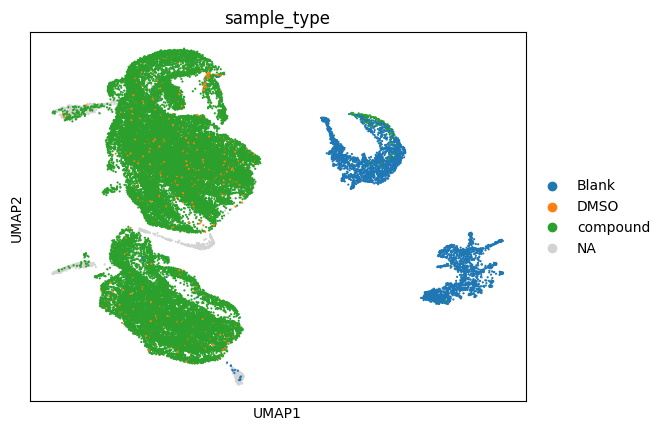

In [ ]:
sc.pl.umap(adata, color="sample_type", size=10)

In [ ]:
sc.tl.rank_genes_groups(adata, groupby="sample_streamlined", reference="DMSO")

/Users/lucas-diedrich/mamba/envs/hackathon/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:458: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "names"] = self.var_names[global_indices]
/Users/lucas-diedrich/mamba/envs/hackathon/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:460: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "scores"] = scores[global_indices]
/Users/lucas-diedrich/mamba/envs/hackathon/lib/python3.12/site-packages/scanpy/tools/_rank_gene

In [ ]:
deg = sc.get.rank_genes_groups_df(adata, group=None)
deg

,group,names,scores,logfoldchanges,pvals,pvals_adj
0,Blank,TGFBI,0.315402,0.387819,7.524835e-01,7.535895e-01
1,Blank,CA4,0.000000,0.000000,1.000000e+00,1.000000e+00
2,Blank,PLA2G2A,0.000000,0.000000,1.000000e+00,1.000000e+00
3,Blank,SHH,0.000000,0.000000,1.000000e+00,1.000000e+00
4,Blank,ST8SIA6,0.000000,0.000000,1.000000e+00,1.000000e+00
...,...,...,...,...,...,...
38693294,HY_Z0816,PDK1,-32.811218,-32.265202,6.374044e-154,4.343273e-151
38693295,HY_Z0816,CD86,-32.823532,-32.308300,5.324195e-154,4.343273e-151
38693296,HY_Z0816,IGFBP5,-33.353111,-32.288464,2.337561e-157,2.654690e-154
38693297,HY_Z0816,XCL2,-34.503044,-32.386608,1.266685e-164,2.157798e-161


In [ ]:
deg.to_parquet("./MCE_Bioactive_Compounds_HEK293T_10μM.deg.parquet")

In [ ]:
del adata.uns["rank_genes_groups"]

In [ ]:
adata.layers["counts"]

array([[  0,   0,  26, ...,  23,   2,   3],
       [  0,   0,  97, ...,  26,  20,  11],
       [  0,   0, 185, ...,  47,  54,  36],
       ...,
       [  0,   0,  25, ...,   5,   1,   2],
       [  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,  47, ...,  15,   5,   9]], shape=(40778, 3407))

In [ ]:
adata.write_h5ad("./MCE_Bioactive_Compounds_HEK293T_10μM.h5ad")